<a href="https://colab.research.google.com/github/DerrickDDInAI/dd-gan/blob/main/dd_gan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Explore Generative Adversarial Network (GAN)
## Objective
Use GAN approach on an image/its trimap to generate a good alpha matte/image cutout.
* Train a generator to generate the alpha matte/image cutout
* Train a discriminator to distinguish the ground truth alpha matte/image cutout from the alpha matte/image cutout created by the generator

## Sources:
* [Simple GAN - GitHub code](https://github.com/aladdinpersson/Machine-Learning-Collection/blob/master/ML/Pytorch/GANs/1.%20SimpleGAN/fc_gan.py)
* [Google courses on GAN](https://developers.google.com/machine-learning/gan)
* [Step by Step Implementation of Conditional Generative Adversarial Networks](https://medium.com/analytics-vidhya/step-by-step-implementation-of-conditional-generative-adversarial-networks-54e4b47497d6)

## What is GAN?
GAN = generative model; creates new data instances similar to the training data.

## How?
GAN pairs 2 neural network models together:
* a generator: learns to generate the target output
* a discriminator: a classifier that learns to distinguish the real data from the output created the generator.

"The generator tries to fool the discriminator, and the discriminator tries to keep from being fooled."
The discriminator penalizes the generator when it performs badly: the backpropagation allows to update the weights of the generator.

"Backpropagation adjusts each weight in the right direction by calculating the weight's impact on the output — how the output would change if you changed the weight."

## GAN applications
* [Examples of different applications (1)](https://developers.google.com/machine-learning/gan/applications)
* [Examples of different applications (2)](https://machinelearningmastery.com/impressive-applications-of-generative-adversarial-networks/)



## Traditional GAN diagram
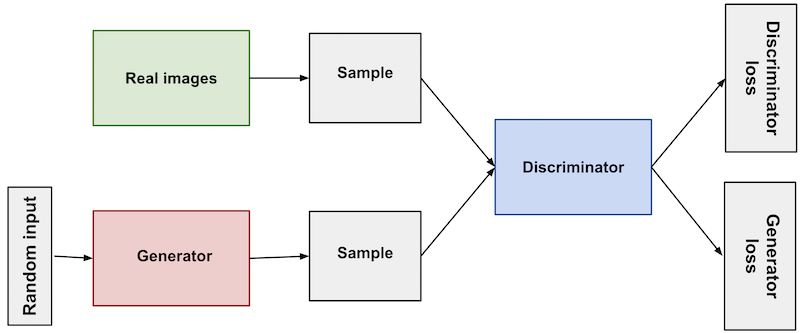

## Adapted GAN diagram
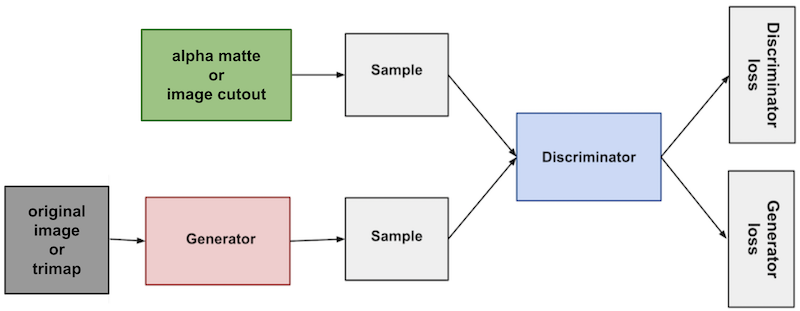

## Training
### For generator

#### input
- random input such as random noise (from experiments, noise distibution is not important => choose easy distribution like a uniform distribution).
- or non-random input --> to shape the output

#### During generator training
Discriminator not training during generator training.

1. Sample random noise.
2. Generate output from sampled random noise.
3. "Real" or "Fake" classification by discriminator
4. Compute generator loss from discriminator classification.
5. Backpropagate through both the discriminator and generator to obtain gradients.
6. Use gradients to change only the generator weights.

### For discriminator
#### Training data
- Real data: positive examples (1)
- fake data created by the generator: negative (0)


#### During discriminator training
Generator creates outputs to train but it's not training (= weights not updated).

1. discriminator classifies real and generator's outputs
2. discriminator loss penalizes discrimator if misclassification => its weights are updated through backpropagation.

### Alternate training
Iteratively:
1. Discriminator trains for 1 or more epochs to better classify real or fake data, but not the generator.
2. Then, generator trains: for 1 or more epochs, but not the discriminator "otherwise the generator would be trying to hit a moving target and might never converge."

As the generator keeps getting better, the discrimator needs to recognize the generator's flaws.

### Convergence
Potential problem: as the generator produces better results, it gets harder for the discriminator to distinguish real data from the fake.

If the generator creates a perfect copy, the discriminator performance drops to 50% accuracy: it's like "flipping a coin to make a prediction".

=> "This progression poses a problem for convergence of the GAN as a whole: the discriminator feedback gets less meaningful over time. If the GAN continues training past the point when the discriminator is giving completely random feedback, then the generator starts to train on junk feedback, and its own quality may collapse."

"For a GAN, convergence is often a fleeting, rather than stable, state."

## Loss functions
GANs try to replicate a probability distribution => loss functions should represents the distance between the distribution of the generator fake data and the distribution of the real data.

### commons loss functions
- minimax loss (minimize `log(1 - D(G(z)))`) or modified minimax loss (maximize `log(D(G(z)))`)
  - D(x) = discriminator's estimate of probability that real data instance x is real
  - G(z) = generator's output when given noise z
  - D(G(z)) = discriminator's estimate of the probability that a fake instance is real

- Wasserstein loss:
  - Critic Loss: `D(x) - D(G(z))`; discriminator tries to maximize this function: to maximize the difference between its output on real instances and its output on fake instances.

  - Generator Loss: D(G(z)); generator tries to maximize the discriminator's output for its fake instances.

      - D(x) = critic's output for a real instance.
      - G(z) = generator's output when given noise z.
      - D(G(z)) = critic's output for a fake instance.

      - Requirements: "weights throughout the GAN be clipped so that they remain within a constrained range."

      - Benefits: "Wasserstein GANs less vulnerable to getting stuck than minimax-based GANs, and avoid problems with vanishing gradients. The earth mover distance also has the advantage of being a true metric: a measure of distance in a space of probability distributions. Cross-entropy is not a metric in this sense."


## Common problems
### Vanishing Gradients
= discriminator too good that the generator can't make progress.

=> Possible solutions:
- Wasserstein loss
- Modified minimax loss

### Mode collapse
= generator always produces the same output(s) to effectively fool the discriminator (when generator over-optimized for that discriminator).

=> Possible solutions:
- Wasserstein loss: as this function allows to avoid vanishing gradients, the discriminator learns to reject the same outputs that the generator keeps creating. => generator will have to produce a new output.
- Unrolled GANs: to prevent generator from over-optimizing for a single discriminator, unrolled GANs uses a generator loss function containing the classifications of
  - the current discriminator
  - and future discriminator versions

### No convergence
Frequent failures to converge

=> Possible solutions:
- Add noise to discriminator inputs
- Penalize discriminator weights

# Install dependencies

# Import

# Upload data & mount drive

# Buid code

In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.datasets as datasets
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
from torch.utils.tensorboard import SummaryWriter  # to print to tensorboard


class Discriminator(nn.Module):
    def __init__(self, in_features):
        super().__init__()
        self.disc = nn.Sequential(
            nn.Linear(in_features, 128),
            nn.LeakyReLU(0.01),
            nn.Linear(128, 1),
            nn.Sigmoid(),
        )

    def forward(self, x):
        return self.disc(x)


class Generator(nn.Module):
    def __init__(self, z_dim, img_dim):
        super().__init__()
        self.gen = nn.Sequential(
            nn.Linear(z_dim, 256),
            nn.LeakyReLU(0.01),
            nn.Linear(256, img_dim),
            nn.Tanh(),  # normalize inputs to [-1, 1] so make outputs [-1, 1]
        )

    def forward(self, x):
        return self.gen(x)


# Hyperparameters etc.
device = "cuda" if torch.cuda.is_available() else "cpu"
lr = 3e-4
z_dim = 64
image_dim = 28 * 28 * 1  # 784
batch_size = 32
num_epochs = 50

disc = Discriminator(image_dim).to(device)
gen = Generator(z_dim, image_dim).to(device)
fixed_noise = torch.randn((batch_size, z_dim)).to(device)
transforms = transforms.Compose(
    [transforms.ToTensor(), transforms.Normalize((0.5,), (0.5,)),]
)

dataset = datasets.MNIST(root="dataset/", transform=transforms, download=True)
loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
opt_disc = optim.Adam(disc.parameters(), lr=lr)
opt_gen = optim.Adam(gen.parameters(), lr=lr)
criterion = nn.BCELoss()
writer_fake = SummaryWriter(f"logs/fake")
writer_real = SummaryWriter(f"logs/real")
step = 0

for epoch in range(num_epochs):
    for batch_idx, (real, _) in enumerate(loader):
        real = real.view(-1, 784).to(device)
        batch_size = real.shape[0]

        ### Train Discriminator: max log(D(x)) + log(1 - D(G(z)))
        noise = torch.randn(batch_size, z_dim).to(device)
        fake = gen(noise)
        disc_real = disc(real).view(-1)
        lossD_real = criterion(disc_real, torch.ones_like(disc_real))
        disc_fake = disc(fake).view(-1)
        lossD_fake = criterion(disc_fake, torch.zeros_like(disc_fake))
        lossD = (lossD_real + lossD_fake) / 2
        disc.zero_grad()
        lossD.backward(retain_graph=True)
        opt_disc.step()

        ### Train Generator: min log(1 - D(G(z))) <-> max log(D(G(z))
        # where the second option of maximizing doesn't suffer from
        # saturating gradients
        output = disc(fake).view(-1)
        lossG = criterion(output, torch.ones_like(output))
        gen.zero_grad()
        lossG.backward()
        opt_gen.step()

        if batch_idx == 0:
            print(
                f"Epoch [{epoch}/{num_epochs}] Batch {batch_idx}/{len(loader)} \
                      Loss D: {lossD:.4f}, loss G: {lossG:.4f}"
            )

            with torch.no_grad():
                fake = gen(fixed_noise).reshape(-1, 1, 28, 28)
                data = real.reshape(-1, 1, 28, 28)
                img_grid_fake = torchvision.utils.make_grid(fake, normalize=True)
                img_grid_real = torchvision.utils.make_grid(data, normalize=True)

                writer_fake.add_image(
                    "Mnist Fake Images", img_grid_fake, global_step=step
                )
                writer_real.add_image(
                    "Mnist Real Images", img_grid_real, global_step=step
                )
                step += 1


KeyboardInterrupt: ignored

### Typical ML setup:
1. Define Model
2. Define Loss function
3. Define optimizer
4. Train model
  - Forward pass
  - Compute Loss
  - Call optimizer and update the weights

# Import

In [17]:
# import module for machine learning
import torch

# import module to visualize results in tensorboard
import torchvision

# import modules for loading the MNIST dataset and transform it
from torchvision import transforms, datasets

# import module to create model
from torch import nn

# import module to define optimizer (to update model parameters)
from torch import optim

# module to print to tensorboard
from torch.utils.tensorboard import SummaryWriter

# import module to display plots and images
%matplotlib inline
from matplotlib import pyplot as plt

# import module for tracking the date of the training
import datetime

# Setup

In [3]:
# select device for computation: "cuda" if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [39]:
# image dimensions
image_dim = 28 * 28 * 1  # 784

# define training hyperparameters
training_hyperparameters = {
    "n_epochs": 100,
    "batch_size": 100,
    "learning_rate": 0.0002
}

# define transformations:
## convert to Tensors and normalize
transform = transforms.Compose([
                                transforms.ToTensor(), 
                                transforms.Normalize((0.5), (0.5))
])

# Load dataset

In [5]:
# Load MNIST dataset
dataloader = torch.utils.data.DataLoader(
    datasets.MNIST(
        root= "/content/drive/MyDrive/AI/projects/dd-gan/dataset/",
        train=True, 
        download=True,
        transform=transform
                   ),
    batch_size=training_hyperparameters["batch_size"],
    shuffle=True
)


tensor(6)



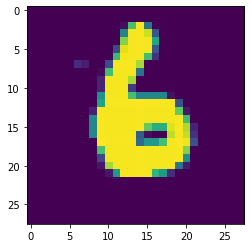

In [6]:
# display 1st image of 1st batch in dataset & its target
for digit_tensor, target_tensor in dataloader:
  print(target_tensor[0])
  plt.imshow(digit_tensor.numpy()[0][0])
  print()
  break

In [7]:
# display shape of 1st image in 1st batch
digit_tensor[0][0].shape

torch.Size([28, 28])

**Important notes**
images of dimension 28x28 = 784 values

=> generator needs to output vector of 784

Then, we can convert vector to 2d matrix of 28x28

# Build Generator model
-> outputs image of dimension 784

In [8]:
class Generator(nn.Module):
  """
  Child class of torch.nn.Module
  """
  def __init__(self):
    """
    Function to create an instance of Generator class
    with all components used by the model.
    Here:
    * input dimension: dimension of random noise
    * output dimension
    * hidden layers
    * output layer
    """
    super(Generator, self).__init__()
    input_dim = 100
    output_dim = image_dim # = 28 x 28 = 784

    # define hidden layer 1
    self.hidden_layer_1 = nn.Sequential(
        
        ## define linear layer with input dim & output dim
        nn.Linear(input_dim, 256),

        ## define activation function:
        ## in LeakyReLU, negative values are multiplied by small constant to reduce value magnitude
        ## (in ReLU, negative values are multiplied by 0)
        nn.LeakyReLU(0.2)
    )

    # define hidden layer 2
    self.hidden_layer_2 = nn.Sequential(
        
        ## define linear layer with previous output dim as input & current output dim
        nn.Linear(256, 512),

        ## define activation function:
        ## in LeakyReLU, negative values are multiplied by small constant to reduce value magnitude
        ## (in ReLU, negative values are multiplied by 0)
        nn.LeakyReLU(0.2)
    )

    # define hidden layer 3
    self.hidden_layer_3 = nn.Sequential(
        
        ## define linear layer with previous output dim as input & current output dim
        nn.Linear(512, 1024),

        ## define activation function:
        ## in LeakyReLU, negative values are multiplied by small constant to reduce value magnitude
        ## (in ReLU, negative values are multiplied by 0)
        nn.LeakyReLU(0.2)
    )

    # define output layer
    self.output_layer = nn.Sequential(
        
        ## define linear layer with previous output dim as input & current output dim
        nn.Linear(1024, output_dim),

        ## define activation function
        nn.Tanh()    
    )
  
  def forward(self, model_input):
    """
    Function to:
    1. pass the input sequentially through the model
    2. returns output (put it on the current device)
    """

    output = self.hidden_layer_1(model_input)
    output = self.hidden_layer_2(output)
    output = self.hidden_layer_3(output)
    output = self.output_layer(output)
    return output.to(device)

# Build Discriminator Model
-> outputs probability of the input being real (vs fake): output of dimension 1


In [10]:
class Discriminator(nn.Module):
  """
  Child class of torch.nn.Module
  """
  def __init__(self):
    """
    Function to create an instance of Discriminator class
    with all components used by the model.
    Here:
    * input dimension: dimension of image created by generator
    * output dimension: probability of image being real
    * hidden layers
    * output layer
    """
    super(Discriminator, self).__init__()
    input_dim = image_dim # = 28 x 28 = 784
    output_dim = 1

    # define hidden layer 1
    self.hidden_layer_1 = nn.Sequential(
        nn.Linear(input_dim, 1024), ## linear layer
        nn.LeakyReLU(0.2), ## activation function
        nn.Dropout(0.3) ## dropout layer
    )

    # define hidden layer 2
    self.hidden_layer_2 = nn.Sequential(
        nn.Linear(1024, 512), ## linear layer
        nn.LeakyReLU(0.2), ## activation function
        nn.Dropout(0.3) ## dropout layer
    )

    # define hidden layer 3
    self.hidden_layer_3 = nn.Sequential(
        nn.Linear(512, 256), ## linear layer
        nn.LeakyReLU(0.2), ## activation function
        nn.Dropout(0.3) ## dropout layer
    )

    # define output layer
    self.output_layer = nn.Sequential(
        nn.Linear(256, output_dim), ## linear layer
        nn.Sigmoid() ## activation function
    )

  def forward(self, model_input):
    """
    Function to:
    1. pass the input sequentially through the model
    2. returns output (put it on the current device)
    """
    output = self.hidden_layer_1(model_input)
    output = self.hidden_layer_2(output)
    output = self.hidden_layer_3(output)
    output = self.output_layer(output)
    return output.to(device)

In [11]:
# initialize models
discriminator = Discriminator()
generator = Generator()

# move model instances into to current device (GPU if available)
discriminator.to(device)
generator.to(device)

Generator(
  (hidden_layer_1): Sequential(
    (0): Linear(in_features=100, out_features=256, bias=True)
    (1): LeakyReLU(negative_slope=0.2)
  )
  (hidden_layer_2): Sequential(
    (0): Linear(in_features=256, out_features=512, bias=True)
    (1): LeakyReLU(negative_slope=0.2)
  )
  (hidden_layer_3): Sequential(
    (0): Linear(in_features=512, out_features=1024, bias=True)
    (1): LeakyReLU(negative_slope=0.2)
  )
  (output_layer): Sequential(
    (0): Linear(in_features=1024, out_features=784, bias=True)
    (1): Tanh()
  )
)

# Define loss & optimizer functions


In [12]:
# define loss function:
## binary cross-entropy loss as there are 2 classes (real and fake)
loss = nn.BCELoss()

# define optimizer functions:
## Adam optimizers
generator_optimizer = optim.Adam(discriminator.parameters(), lr=training_hyperparameters["learning_rate"])
discriminator_optimizer = optim.Adam(discriminator.parameters(), lr=training_hyperparameters["learning_rate"])

# Training loop

* **Update Discriminator model**
  1. Clear optimizer gradients with optimizer.zero_grad()
  2. Forward pass to discriminator with real data as input and obtain output
  3. Compute loss with discriminator output and true label (1 for real data)
  4. Forward pass to discriminator with generated data and obtain output
  5. Compute loss with discriminator output and fake labels (0 for generated data)
  6. Average both losses
  7. Call optimizer.step() to backpropagate and update weights of discriminator model

* **Update Generator model**
  1. Clear optimizer gradients with optimizer.zero_grad()
  2. Forward pass to discriminator with generated data as input an obtain output
  3. Compute loss with discriminator output and true label (1 for fake data) as objective of generator is to fool discriminator
  4. Call optimizer.step() to backpropagate and update weights of generator model

In [15]:
datetime.datetime.now().strftime("%Y%m%d")

'20210616'

Streaming output truncated to the last 5000 lines.
[1/100]: descriminator_loss: 0.556, generator_loss: 0.426 
[1/100]: descriminator_loss: 0.556, generator_loss: 0.426 
[1/100]: descriminator_loss: 0.556, generator_loss: 0.426 
[1/100]: descriminator_loss: 0.556, generator_loss: 0.426 
[1/100]: descriminator_loss: 0.556, generator_loss: 0.426 
[1/100]: descriminator_loss: 0.556, generator_loss: 0.426 
[1/100]: descriminator_loss: 0.556, generator_loss: 0.426 
[1/100]: descriminator_loss: 0.556, generator_loss: 0.426 
[1/100]: descriminator_loss: 0.556, generator_loss: 0.426 
[1/100]: descriminator_loss: 0.556, generator_loss: 0.426 
[1/100]: descriminator_loss: 0.556, generator_loss: 0.426 
[1/100]: descriminator_loss: 0.556, generator_loss: 0.426 
[1/100]: descriminator_loss: 0.556, generator_loss: 0.426 
[1/100]: descriminator_loss: 0.556, generator_loss: 0.426 
[1/100]: descriminator_loss: 0.556, generator_loss: 0.426 
[1/100]: descriminator_loss: 0.556, generator_loss: 0.426 
[1/10

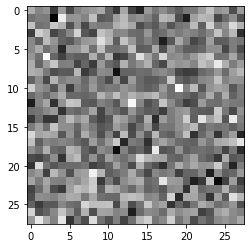

Streaming output truncated to the last 5000 lines.
[11/100]: descriminator_loss: 0.564, generator_loss: 0.417 
[11/100]: descriminator_loss: 0.564, generator_loss: 0.417 
[11/100]: descriminator_loss: 0.564, generator_loss: 0.417 
[11/100]: descriminator_loss: 0.564, generator_loss: 0.417 
[11/100]: descriminator_loss: 0.564, generator_loss: 0.417 
[11/100]: descriminator_loss: 0.564, generator_loss: 0.417 
[11/100]: descriminator_loss: 0.564, generator_loss: 0.417 
[11/100]: descriminator_loss: 0.564, generator_loss: 0.417 
[11/100]: descriminator_loss: 0.564, generator_loss: 0.417 
[11/100]: descriminator_loss: 0.564, generator_loss: 0.417 
[11/100]: descriminator_loss: 0.564, generator_loss: 0.417 
[11/100]: descriminator_loss: 0.564, generator_loss: 0.417 
[11/100]: descriminator_loss: 0.564, generator_loss: 0.417 
[11/100]: descriminator_loss: 0.564, generator_loss: 0.417 
[11/100]: descriminator_loss: 0.564, generator_loss: 0.417 
[11/100]: descriminator_loss: 0.564, generator_lo

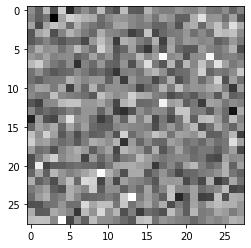

Streaming output truncated to the last 5000 lines.
[21/100]: descriminator_loss: 0.565, generator_loss: 0.414 
[21/100]: descriminator_loss: 0.565, generator_loss: 0.414 
[21/100]: descriminator_loss: 0.565, generator_loss: 0.414 
[21/100]: descriminator_loss: 0.565, generator_loss: 0.414 
[21/100]: descriminator_loss: 0.565, generator_loss: 0.414 
[21/100]: descriminator_loss: 0.565, generator_loss: 0.414 
[21/100]: descriminator_loss: 0.565, generator_loss: 0.414 
[21/100]: descriminator_loss: 0.565, generator_loss: 0.414 
[21/100]: descriminator_loss: 0.565, generator_loss: 0.414 
[21/100]: descriminator_loss: 0.565, generator_loss: 0.414 
[21/100]: descriminator_loss: 0.565, generator_loss: 0.414 
[21/100]: descriminator_loss: 0.565, generator_loss: 0.414 
[21/100]: descriminator_loss: 0.565, generator_loss: 0.414 
[21/100]: descriminator_loss: 0.565, generator_loss: 0.414 
[21/100]: descriminator_loss: 0.565, generator_loss: 0.414 
[21/100]: descriminator_loss: 0.565, generator_lo

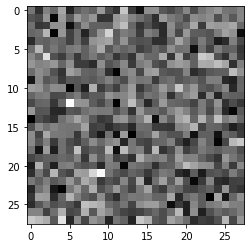

Streaming output truncated to the last 5000 lines.
[31/100]: descriminator_loss: 0.568, generator_loss: 0.410 
[31/100]: descriminator_loss: 0.568, generator_loss: 0.410 
[31/100]: descriminator_loss: 0.568, generator_loss: 0.410 
[31/100]: descriminator_loss: 0.568, generator_loss: 0.410 
[31/100]: descriminator_loss: 0.568, generator_loss: 0.410 
[31/100]: descriminator_loss: 0.568, generator_loss: 0.410 
[31/100]: descriminator_loss: 0.568, generator_loss: 0.410 
[31/100]: descriminator_loss: 0.568, generator_loss: 0.410 
[31/100]: descriminator_loss: 0.568, generator_loss: 0.410 
[31/100]: descriminator_loss: 0.568, generator_loss: 0.410 
[31/100]: descriminator_loss: 0.568, generator_loss: 0.410 
[31/100]: descriminator_loss: 0.568, generator_loss: 0.410 
[31/100]: descriminator_loss: 0.568, generator_loss: 0.410 
[31/100]: descriminator_loss: 0.568, generator_loss: 0.410 
[31/100]: descriminator_loss: 0.568, generator_loss: 0.410 
[31/100]: descriminator_loss: 0.568, generator_lo

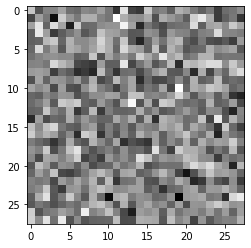

Streaming output truncated to the last 5000 lines.
[41/100]: descriminator_loss: 0.572, generator_loss: 0.404 
[41/100]: descriminator_loss: 0.572, generator_loss: 0.404 
[41/100]: descriminator_loss: 0.572, generator_loss: 0.404 
[41/100]: descriminator_loss: 0.572, generator_loss: 0.404 
[41/100]: descriminator_loss: 0.572, generator_loss: 0.404 
[41/100]: descriminator_loss: 0.572, generator_loss: 0.404 
[41/100]: descriminator_loss: 0.572, generator_loss: 0.404 
[41/100]: descriminator_loss: 0.572, generator_loss: 0.404 
[41/100]: descriminator_loss: 0.572, generator_loss: 0.404 
[41/100]: descriminator_loss: 0.572, generator_loss: 0.404 
[41/100]: descriminator_loss: 0.572, generator_loss: 0.404 
[41/100]: descriminator_loss: 0.572, generator_loss: 0.404 
[41/100]: descriminator_loss: 0.572, generator_loss: 0.404 
[41/100]: descriminator_loss: 0.572, generator_loss: 0.404 
[41/100]: descriminator_loss: 0.572, generator_loss: 0.404 
[41/100]: descriminator_loss: 0.572, generator_lo

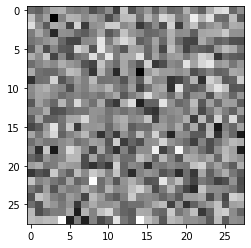

Streaming output truncated to the last 5000 lines.
[51/100]: descriminator_loss: 0.578, generator_loss: 0.400 
[51/100]: descriminator_loss: 0.578, generator_loss: 0.400 
[51/100]: descriminator_loss: 0.578, generator_loss: 0.400 
[51/100]: descriminator_loss: 0.578, generator_loss: 0.400 
[51/100]: descriminator_loss: 0.578, generator_loss: 0.400 
[51/100]: descriminator_loss: 0.578, generator_loss: 0.400 
[51/100]: descriminator_loss: 0.578, generator_loss: 0.400 
[51/100]: descriminator_loss: 0.578, generator_loss: 0.400 
[51/100]: descriminator_loss: 0.578, generator_loss: 0.400 
[51/100]: descriminator_loss: 0.578, generator_loss: 0.400 
[51/100]: descriminator_loss: 0.578, generator_loss: 0.400 
[51/100]: descriminator_loss: 0.578, generator_loss: 0.400 
[51/100]: descriminator_loss: 0.578, generator_loss: 0.400 
[51/100]: descriminator_loss: 0.578, generator_loss: 0.400 
[51/100]: descriminator_loss: 0.578, generator_loss: 0.400 
[51/100]: descriminator_loss: 0.578, generator_lo

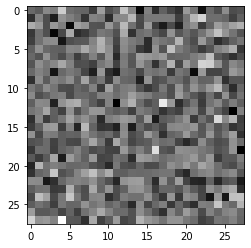

Streaming output truncated to the last 5000 lines.
[61/100]: descriminator_loss: 0.586, generator_loss: 0.394 
[61/100]: descriminator_loss: 0.586, generator_loss: 0.394 
[61/100]: descriminator_loss: 0.586, generator_loss: 0.394 
[61/100]: descriminator_loss: 0.586, generator_loss: 0.394 
[61/100]: descriminator_loss: 0.586, generator_loss: 0.394 
[61/100]: descriminator_loss: 0.586, generator_loss: 0.394 
[61/100]: descriminator_loss: 0.586, generator_loss: 0.394 
[61/100]: descriminator_loss: 0.586, generator_loss: 0.394 
[61/100]: descriminator_loss: 0.586, generator_loss: 0.394 
[61/100]: descriminator_loss: 0.586, generator_loss: 0.394 
[61/100]: descriminator_loss: 0.586, generator_loss: 0.394 
[61/100]: descriminator_loss: 0.586, generator_loss: 0.394 
[61/100]: descriminator_loss: 0.586, generator_loss: 0.394 
[61/100]: descriminator_loss: 0.586, generator_loss: 0.394 
[61/100]: descriminator_loss: 0.586, generator_loss: 0.394 
[61/100]: descriminator_loss: 0.586, generator_lo

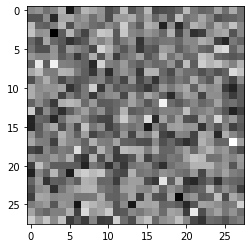

Streaming output truncated to the last 5000 lines.
[71/100]: descriminator_loss: 0.592, generator_loss: 0.389 
[71/100]: descriminator_loss: 0.592, generator_loss: 0.389 
[71/100]: descriminator_loss: 0.592, generator_loss: 0.389 
[71/100]: descriminator_loss: 0.592, generator_loss: 0.389 
[71/100]: descriminator_loss: 0.592, generator_loss: 0.389 
[71/100]: descriminator_loss: 0.592, generator_loss: 0.389 
[71/100]: descriminator_loss: 0.592, generator_loss: 0.389 
[71/100]: descriminator_loss: 0.592, generator_loss: 0.389 
[71/100]: descriminator_loss: 0.592, generator_loss: 0.389 
[71/100]: descriminator_loss: 0.592, generator_loss: 0.389 
[71/100]: descriminator_loss: 0.592, generator_loss: 0.389 
[71/100]: descriminator_loss: 0.592, generator_loss: 0.389 
[71/100]: descriminator_loss: 0.592, generator_loss: 0.389 
[71/100]: descriminator_loss: 0.592, generator_loss: 0.389 
[71/100]: descriminator_loss: 0.592, generator_loss: 0.389 
[71/100]: descriminator_loss: 0.592, generator_lo

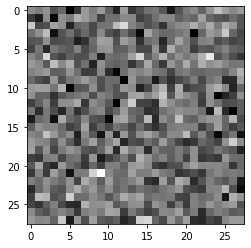

Streaming output truncated to the last 5000 lines.
[81/100]: descriminator_loss: 0.599, generator_loss: 0.385 
[81/100]: descriminator_loss: 0.599, generator_loss: 0.385 
[81/100]: descriminator_loss: 0.599, generator_loss: 0.385 
[81/100]: descriminator_loss: 0.599, generator_loss: 0.385 
[81/100]: descriminator_loss: 0.599, generator_loss: 0.385 
[81/100]: descriminator_loss: 0.599, generator_loss: 0.385 
[81/100]: descriminator_loss: 0.599, generator_loss: 0.385 
[81/100]: descriminator_loss: 0.599, generator_loss: 0.385 
[81/100]: descriminator_loss: 0.599, generator_loss: 0.385 
[81/100]: descriminator_loss: 0.599, generator_loss: 0.385 
[81/100]: descriminator_loss: 0.599, generator_loss: 0.385 
[81/100]: descriminator_loss: 0.599, generator_loss: 0.385 
[81/100]: descriminator_loss: 0.599, generator_loss: 0.385 
[81/100]: descriminator_loss: 0.599, generator_loss: 0.385 
[81/100]: descriminator_loss: 0.599, generator_loss: 0.385 
[81/100]: descriminator_loss: 0.599, generator_lo

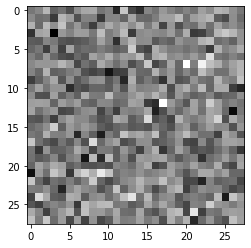

Le flux de sortie a été tronqué et ne contient que les 5000 dernières lignes.
[91/100]: descriminator_loss: 0.605, generator_loss: 0.379 
[91/100]: descriminator_loss: 0.605, generator_loss: 0.379 
[91/100]: descriminator_loss: 0.605, generator_loss: 0.379 
[91/100]: descriminator_loss: 0.605, generator_loss: 0.379 
[91/100]: descriminator_loss: 0.605, generator_loss: 0.379 
[91/100]: descriminator_loss: 0.605, generator_loss: 0.379 
[91/100]: descriminator_loss: 0.605, generator_loss: 0.379 
[91/100]: descriminator_loss: 0.605, generator_loss: 0.379 
[91/100]: descriminator_loss: 0.605, generator_loss: 0.379 
[91/100]: descriminator_loss: 0.605, generator_loss: 0.379 
[91/100]: descriminator_loss: 0.605, generator_loss: 0.379 
[91/100]: descriminator_loss: 0.605, generator_loss: 0.379 
[91/100]: descriminator_loss: 0.605, generator_loss: 0.379 
[91/100]: descriminator_loss: 0.605, generator_loss: 0.379 
[91/100]: descriminator_loss: 0.605, generator_loss: 0.379 
[91/100]: descriminato

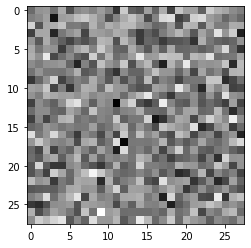

[99/100]: descriminator_loss: 0.617, generator_loss: 0.371 
[99/100]: descriminator_loss: 0.617, generator_loss: 0.371 
[99/100]: descriminator_loss: 0.617, generator_loss: 0.371 
[99/100]: descriminator_loss: 0.617, generator_loss: 0.371 
[99/100]: descriminator_loss: 0.617, generator_loss: 0.371 
[99/100]: descriminator_loss: 0.617, generator_loss: 0.371 
[99/100]: descriminator_loss: 0.617, generator_loss: 0.371 
[99/100]: descriminator_loss: 0.617, generator_loss: 0.371 
[99/100]: descriminator_loss: 0.617, generator_loss: 0.371 
[99/100]: descriminator_loss: 0.617, generator_loss: 0.371 
[99/100]: descriminator_loss: 0.617, generator_loss: 0.371 
[99/100]: descriminator_loss: 0.617, generator_loss: 0.371 
[99/100]: descriminator_loss: 0.617, generator_loss: 0.371 
[99/100]: descriminator_loss: 0.617, generator_loss: 0.371 
[99/100]: descriminator_loss: 0.617, generator_loss: 0.371 
[99/100]: descriminator_loss: 0.617, generator_loss: 0.371 
[99/100]: descriminator_loss: 0.617, gen

In [40]:
# hyperparameters
n_epochs: int = training_hyperparameters["n_epochs"]
batch_size: int = training_hyperparameters["batch_size"]
lr: float = training_hyperparameters["learning_rate"]

# log progress
today_date = datetime.datetime.now().strftime("%Y%m%d")
writer_fake = SummaryWriter(f"/content/drive/MyDrive/AI/projects/dd-gan/tensorboard/logs_{today_date}/fake")
writer_real = SummaryWriter(f"/content/drive/MyDrive/AI/projects/dd-gan/tensorboard/logs_{today_date}/real")
step = 0

for epoch_idx in range(n_epochs):
  discriminator_loss_list: list = []
  generator_loss_list: list = []

  for batch_idx, data_input in enumerate(dataloader):

    # generate noise & move it to device
    noise = torch.randn(batch_size,100).to(device)

    # forward pass
    generated_data = generator(noise) # batch size x 784


    ##############################
    # train discriminator
    ##############################

    # get true data
    true_data = data_input[0].view(batch_size, 784).to(device) # batch size x 784
    
    digit_labels = data_input[1] # batch size
    true_labels = torch.ones(batch_size).to(device)

    # clear optimizer gradients
    discriminator_optimizer.zero_grad()

    # forward pass with true data as input
    discriminator_output_for_true_data = discriminator(true_data).view(batch_size)

    # compute loss
    true_discriminator_loss = loss(discriminator_output_for_true_data, true_labels)

    # forward_pass with generated data as input
    discriminator_output_for_generated_data = discriminator(generated_data.detach()).view(batch_size)

    # compute loss
    generator_discriminator_loss = loss(discriminator_output_for_generated_data, torch.zeros(batch_size).to(device))

    # average loss
    discriminator_loss = (true_discriminator_loss + generator_discriminator_loss)/2

    # backpropagate losses for Discriminator model
    discriminator_loss.backward()
    discriminator_optimizer.step()

    discriminator_loss_list.append(discriminator_loss.data.item())

    ##############################
    # train generator
    ##############################

    # clear optimizer gradients
    generator_optimizer.zero_grad()

    # optional: generate data again
    # generated_data = generator(noise) # batch size x 784

    # forward pass with generated data as input
    discriminator_output_on_generated_data = discriminator(generated_data).view(batch_size)

    # compute loss
    generator_loss = loss(discriminator_output_on_generated_data, true_labels)

    # backpropagate losses for Generator model
    generator_loss.backward()
    generator_optimizer.step()

    generator_loss_list.append(generator_loss.data.item())


    # evaluate model
    if ((batch_idx + 1)% 500 == 0 and (epoch_idx + 1)%10 == 0):
      print("Training Steps Completed: ", batch_idx)

      with torch.no_grad():
        noise = torch.randn(batch_size, 100).to(device)
        generated_data = generator(noise).cpu().view(batch_size, 28, 28).reshape(-1,1,28,28)
        print(type(generated_data))
        print(generated_data.shape)

        true_data = true_data.reshape(-1,1,28,28)
        print(type(true_data))
        print(true_data.shape)

        img_grid_fake = torchvision.utils.make_grid(generated_data, normalize=True)
        img_grid_real = torchvision.utils.make_grid(true_data, normalize=True)

        writer_fake.add_image(
            "Mnist Fake Images", img_grid_fake, global_step=step
        )
        writer_real.add_image(
            "Mnist Real Images", img_grid_real, global_step=step
        )
        step += 1


        for x in generated_data:
          plt.imshow(x.detach()[0].numpy(), interpolation="nearest", cmap="gray")
          plt.show()

          break


    print(f"[{epoch_idx:d}/{n_epochs:d}]: descriminator_loss: {torch.mean(torch.FloatTensor(discriminator_loss_list)):.3f}, generator_loss: {torch.mean(torch.FloatTensor(generator_loss_list)):.3f} ")


# Check results on Tensorboard

Sources:
- [tensorboard in notebooks](https://colab.research.google.com/github/tensorflow/tensorboard/blob/master/docs/tensorboard_in_notebooks.ipynb#scrollTo=IlDz2oXBgnZ9)

In [20]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [41]:
%tensorboard --logdir /content/drive/MyDrive/AI/projects/dd-gan/tensorboard/logs_20210616

<IPython.core.display.Javascript object>

In [20]:
# use tensorboard.notebook APIs for more control:
from tensorboard import notebook
notebook.list() # View open TensorBoard instances

Known TensorBoard instances:
  - port 6006: logdir /content/drive/MyDrive/AI/projects/dd-gan/tensorboard/logs (started 0:08:12 ago; pid 1041)


In [21]:
# control TensorBoard display. If no port is provided, 
# the most recently launched TensorBoard is used
notebook.display(port=6006, height=1000) 

Selecting TensorBoard with logdir /content/drive/MyDrive/AI/projects/dd-gan/tensorboard/logs (started 0:08:47 ago; port 6006, pid 1041).


<IPython.core.display.Javascript object>

# Conditional GANs

# Build Generator model


In [ ]:
class Generator(nn.Module):
  """
  Child class of torch.nn.Module
  """
  def __init__(self):
    """
    Function to create an instance of Generator class
    with all components used by the model.
    Here:
    * input dimension: dimension of random noise
    * output dimension
    * embedding layer
    * hidden layers
    * output layer
    """
    super(Generator, self).__init__()
    input_dim = 100 + 10 # + 10 to concatenate the noise and the 10-dimensional embedding 
    output_dim = image_dim # = 28 x 28 = 784

    # define embedding layerr of shape (10,10) 
    # to have a 10-dimensional encoding for all the 10 digits
    self.label_embedding = nn.Embedding(10,10)

    # define hidden layer 1
    self.hidden_layer_1 = nn.Sequential(
        
        ## define linear layer with input dim & output dim
        nn.Linear(input_dim, 256),

        ## define activation function:
        ## in LeakyReLU, negative values are multiplied by small constant to reduce value magnitude
        ## (in ReLU, negative values are multiplied by 0)
        nn.LeakyReLU(0.2)
    )

    # define hidden layer 2
    self.hidden_layer_2 = nn.Sequential(
        
        ## define linear layer with previous output dim as input & current output dim
        nn.Linear(256, 512),

        ## define activation function:
        ## in LeakyReLU, negative values are multiplied by small constant to reduce value magnitude
        ## (in ReLU, negative values are multiplied by 0)
        nn.LeakyReLU(0.2)
    )

    # define hidden layer 3
    self.hidden_layer_3 = nn.Sequential(
        
        ## define linear layer with previous output dim as input & current output dim
        nn.Linear(512, 1024),

        ## define activation function:
        ## in LeakyReLU, negative values are multiplied by small constant to reduce value magnitude
        ## (in ReLU, negative values are multiplied by 0)
        nn.LeakyReLU(0.2)
    )

    # define output layer
    self.output_layer = nn.Sequential(
        
        ## define linear layer with previous output dim as input & current output dim
        nn.Linear(1024, output_dim),

        ## define activation function
        nn.Tanh()

    )
  
  def forward(self, model_input, labels):
    """
    Function to:
    1. pass the input sequentially through the model
    2. returns output (put it on the current device)
    """
    category = self.label_embedding(labels)
    model_input = torch.cat([model_input, category], 1)

    output = self.hidden_layer_1(model_input)
    output = self.hidden_layer_2(output)
    output = self.hidden_layer_3(output)
    output = self.output_layer(output)
    return output.to(device)

# Build Discriminator model

In [ ]:
class Discriminator(nn.Module):
  """
  Child class of torch.nn.Module
  """
  def __init__(self):
    """
    Function to create an instance of Discriminator class
    with all components used by the model.
    Here:
    * input dimension: dimension of image created by generator
    * output dimension: probability of image being real
    * hidden layers
    * output layer
    """
    super(Discriminator, self).__init__()
    input_dim = image_dim + 10 # = 28x28 + 10 to concatenate the noise and the 10-dimensional embedding 
    output_dim = 1
    self.label_embedding = nn.Embedding(10,10)

    # define hidden layer 1
    self.hidden_layer_1 = nn.Sequential(
        nn.Linear(input_dim, 1024), ## linear layer
        nn.LeakyReLU(0.2), ## activation function
        nn.Dropout(0.3) ## dropout layer
    )

    # define hidden layer 2
    self.hidden_layer_2 = nn.Sequential(
        nn.Linear(1024, 512), ## linear layer
        nn.LeakyReLU(0.2), ## activation function
        nn.Dropout(0.3) ## dropout layer
    )

    # define hidden layer 3
    self.hidden_layer_3 = nn.Sequential(
        nn.Linear(512, 256), ## linear layer
        nn.LeakyReLU(0.2), ## activation function
        nn.Dropout(0.3) ## dropout layer
    )

    # define output layer
    self.output_layer = nn.Sequential(
        nn.Linear(256, output_dim), ## linear layer
        nn.Sigmoid() ## activation function
    )

  def forward(self, model_input, labels):
    """
    Function to:
    1. pass the input sequentially through the model
    2. returns output (put it on the current device)
    """
    category = self.label_embedding(labels)
    model_input = torch.cat([model_input, category], 1)
    output = self.hidden_layer_1(model_input)
    output = self.hidden_layer_2(output)
    output = self.hidden_layer_3(output)
    output = self.output_layer(output)
    return output.to(device)

# Training loop

In [ ]:
# hyperparameters
n_epochs: int = training_hyperparameters["n_epochs"]
batch_size: int = training_hyperparameters["batch_size"]

for epoch_idx in range(n_epochs):
  discriminator_loss_list: list = []
  generator_loss_list: list = []

  for batch_idx, data_input in enumerate(dataloader):

    # generate noise & move it to device
    noise = torch.randn(batch_size,100).to(device)

    # randomly choose a label for the generated data
    fake_labels = torch.randint(0,10,(batch_size,)).to(device)

    # forward pass: generate data
    generated_data = generator(noise, fake_labels) # batch size x 784

    ####################
    # Discriminator
    ####################
    # get true data
    true_data = data_input[0].view(batch_size, 784).to(device) # batch size x 784
    
    digit_labels = data_input[1] # batch size
    true_labels = torch.ones(batch_size).to(device)

    # clear optimizer gradients
    discriminator_optimizer.zero_grad()

    # forward pass with true data as input & digit labels as category
    discriminator_output_for_true_data = discriminator(true_data, digit_labels).view(batch_size)

    # compute loss
    true_discriminator_loss = loss(discriminator_output_for_true_data, true_labels)

    # forward_pass with generated data as input & digit labels as category
    discriminator_output_for_generated_data = discriminator(generated_data.detach(), fake_labels).view(batch_size)

    # compute loss
    generator_discriminator_loss = loss(discriminator_output_for_generated_data, torch.zeros(batch_size).to(device))

    # average loss
    discriminator_loss = (true_discriminator_loss + generator_discriminator_loss)/2

    # backpropagate losses for Discriminator model
    discriminator_loss.backward()
    discriminator_optimizer.step()

    discriminator_loss_list.append(discriminator_loss.data.item())


    ####################
    # Generator
    ####################
    # clear optimizer gradients
    generator_optimizer.zero_grad()

    # optional: generate data again
    generated_data = generator(noise, fake_labels) # batch size x 784

    # forward pass with generated data as input
    discriminator_output_for_generated_data = discriminator(generated_data, fake_labels).view(batch_size)

    # compute loss
    generator_loss = loss(discriminator_output_for_generated_data, true_labels)

    # backpropagate losses for Generator model
    generator_loss.backward()
    generator_optimizer.step()

    generator_loss_list.append(generator_loss.data.item())


    # evaluate model
    if ((batch_idx + 1)% 500 == 0 and (epoch_idx + 1)%10 == 0):
      print("Training Steps Completed: ", batch_idx)

      with torch.no_grad():
        noise = torch.randn(batch_size, 100).to(device)
        generated_data = generator(noise).cpu().view(batch_size, 28, 28)
        for x in generated_data:
          plt.imshow(x.detach().numpy(), interpolation="nearest", cmap="gray")
          plt.show()

          break


    print(f"[{epoch_idx:d}/{n_epochs:d}]: descriminator_loss: {torch.mean(torch.FloatTensor(discriminator_loss_list)):.3f}, generator_loss: {torch.mean(torch.FloatTensor(generator_loss_list)):.3f} ")




In [32]:
test.shape

torch.Size([100, 1, 28, 28])